## Poster Genre Transformation


Transform the movie posters to the ones containing key features in other genres and visualize the resulting transformations to see if it fits with subjective judgements. The image style transformation is done through the fast arbitrary image style transfer held on Tensorflow Hub (https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2). 

In [1]:
import os
import tensorflow as tf
import tensorflow_hub as hub

import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pandas as pd

import numpy as np
from PIL import Image
import random

In [2]:
# Download files using the given URL if they do not exist in the current directory
def download_if_missing(url, target, extract=True):
  if os.path.exists(target):
    return target
  return tf.keras.utils.get_file(target, origin=url, extract=extract)

In [3]:
# Download the csv file and the image folder 
root = '/content'
csv_url = 'https://storage.googleapis.com/coms4995_final_project_yc/collected_dataframe.csv'
image_url = 'https://storage.googleapis.com/coms4995_final_project_yc/Data.zip'
csv_path = os.path.join(root, "data.csv")
image_zip_path = os.path.join(root, "image.zip")
download_if_missing(csv_url, csv_path)
download_if_missing(image_url, image_zip_path)

'/content/image.zip'

In [4]:
# Unzip the image folder 
image_path = os.path.join(root, "image")
if os.path.exists(image_path) == False:
  !unzip -q $image_zip_path -d $image_path
image_path = os.path.join(image_path, "Data")

In [5]:
# Load the csv file as dataframe 
df = pd.read_csv(csv_path)
df['Poster'] = [os.path.join(image_path, i) for i in list(df['Poster'])] 
df = df.drop(['imdbId', 'Imdb Link', 'IMDB Score'], axis = 1)
df['Genre'] = [i.split("|") for i in list(df['Genre'])]
image_path_list = list(df['Poster'])

In [6]:
# Decode the image into the tensorflow data
def image_decode(img_path):
  img= tf.io.read_file(img_path)
  img = tf.image.decode_jpeg(img, channels=3)
  img = tf.image.resize(img, [256, 256])
  result = img / 255.0
  return result

In [7]:
# Change the tensor type data back to its array form (image)
def tensor_to_image(tensor):
  tensor = tensor*255
  tensor = np.array(tensor, dtype=np.uint8)
  if np.ndim(tensor)>3:
    assert tensor.shape[0] == 1
    tensor = tensor[0]
  return tensor

### Content Image and Style Image

The style image selected for this poster transformation is the poster for the movie 'Toy Story (1995)'. As displayed in the next cell, this poster shows very strong characteristics, including bright colors and animation characters. It has the genre attachments of 'Comedy', 'Animation', and 'Adventure', which fit with the subjective judgements on the poster. Therefore, this poster image is used as the style image to transform other posters which do not have those three selected genre attachments. 

#### Example

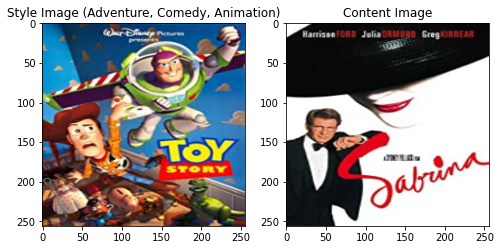

In [8]:
genre_list = list(df['Genre'])
index = 6
selected_image_path = image_path_list[index]
selected_image_genre = genre_list[index]
content_image = image_decode(selected_image_path)

# Select an image of horror
style_image = image_decode(df.loc[0, 'Poster'])
plt.figure(figsize=(8,6))
plt.subplot(1, 2, 1)
plt.title("Style Image (Adventure, Comedy, Animation)")
plt.imshow(style_image)

plt.subplot(1, 2, 2)
plt.title("Content Image")
plt.imshow(content_image)
plt.show()

Select the poster images whose movie genre attachments do not contain the selected three genres: 'Adventure', 'Animation', and 'Comedy'. 

In [9]:
# Select image that have no 'Adventure', 'Animation', 'Comedy' genres
selected_index = []
for i in range(len(df)):
  genre = df.loc[i, 'Genre']
  if 'Animation' not in genre and 'Comedy' not in genre and 'Adventure' not in genre:
    selected_index.append(i)

Sample 100 content images from the selected list to do the image transformation. 

In [10]:
rand_num = 100
sample_index = random.sample(selected_index, rand_num)
sample_image = []
sample_genre = []
for index in sample_index:
  record = df.iloc[index]
  genre = record['Genre']
  img = record['Poster']
  sample_image.append(img)
  sample_genre.append(genre)

In [11]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [12]:
# Build a folder for new transformed images 
new_folder = '/content/drive/MyDrive/FinalProjectTransformedImages'

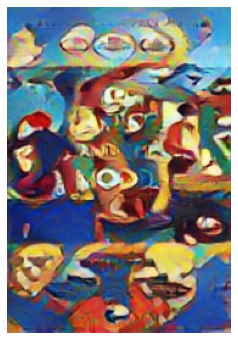

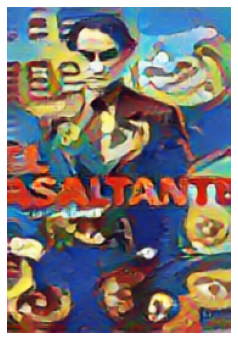

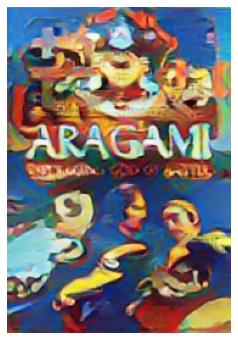

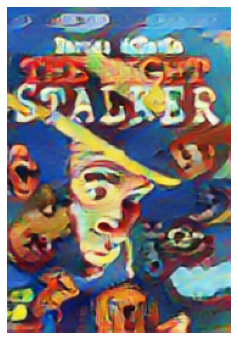

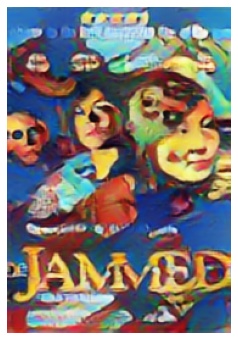

...

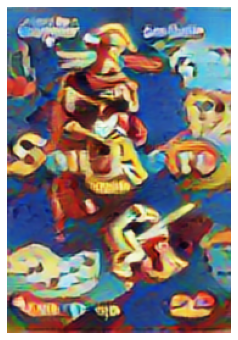

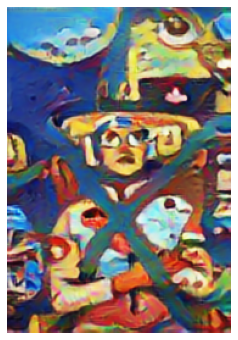

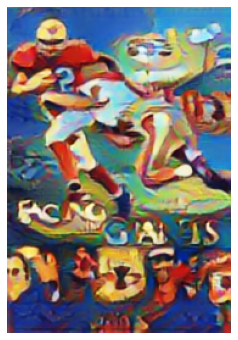

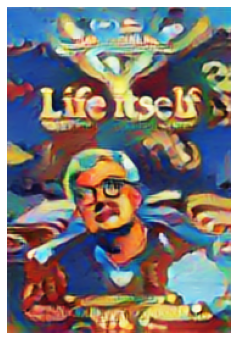

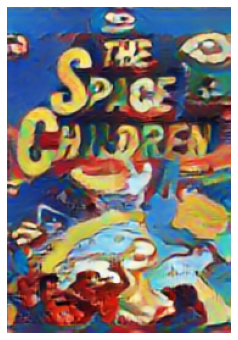

In [13]:
# Load Tensorflow Hub
hub_module = hub.load('https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2')
# Select the style image and preprocess the image 
style_image = plt.imread(df.loc[0, 'Poster'])
style_image = style_image.astype(np.float32)[np.newaxis, ...] / 255.
style_image = tf.image.resize(style_image, (256, 256))

for i in range(rand_num):
  content_image = plt.imread(sample_image[i])
  content_image = content_image.astype(np.float32)[np.newaxis, ...] / 255.
  outputs = hub_module(tf.constant(content_image), tf.constant(style_image))
  stylized_image = outputs[0]
  result = tensor_to_image(stylized_image)
  plt.figure(figsize = (8,6))
  plt.imshow(result)
  plt.axis('off')
  plt.savefig(os.path.join(new_folder, "image" + str(i)), bbox_inches='tight')
  plt.show()